# Martin2019 (GSE134809_human_ileal_Crohns) 
# Cell type annotation

In [1]:
# load required modules
import scanpy as sc
import besca as bc
import pandas as pd
import numpy as np
import os
import pkg_resources

#import numpy as np
#from matplotlib import pyplot
#import sys

#setup document
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures
sc.logging.print_versions()

./.conda/envs/besca_test/lib/python3.6/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning,


scanpy==1.4.5.post2 anndata==0.7.1 umap==0.3.10 numpy==1.17.5 scipy==1.4.1 pandas==0.24.1 scikit-learn==0.22.1 statsmodels==0.11.0 python-igraph==0.8.2 louvain==0.6.1


In [2]:
# define filepath (this is the folder that contains "raw" and "analyzed")
root_path = os.getcwd()

# input: results from standard workflow
analysis_name = 'standard_workflow_besca2_0'
results_folder = os.path.join(root_path, 'analyzed', analysis_name)
input_data = os.path.join(results_folder, analysis_name + '.h5ad') # specify a .h5ad file for storing the results

# define output directories
outdir_data = results_folder
outdir_figures = os.path.join(results_folder, 'figures')
outdir_results = os.path.join(results_folder, 'results')
sc.settings.figdir = os.path.join(outdir_figures)

os.makedirs(outdir_data, exist_ok=True)
os.makedirs(outdir_figures, exist_ok=True)
os.makedirs(outdir_results, exist_ok=True)

In [3]:
#reload our data from previously written out AnnData object
adata = sc.read(input_data)

In [4]:
adata

AnnData object with n_obs × n_vars = 62202 × 1417 
    obs: 'CELL', 'CONDITION', 'Sample_geo_accession', 'Sample_title', 'Subject', 'tissue', 'status', '10x chemistry', 'Sample_relation', 'Sample_relation_2', 'Sample_supplementary_file_1', 'Sample_supplementary_file_2', 'Sample_supplementary_file_3', 'ID_REF', 'Barcode', 'Type', 'Cluster', 'Lane', 'Subtype', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [5]:
adata.obs.head()

,CELL,CONDITION,Sample_geo_accession,Sample_title,Subject,tissue,status,10x chemistry,Sample_relation,Sample_relation_2,...,Barcode,Type,Cluster,Lane,Subtype,percent_mito,n_counts,n_genes,batch,leiden
index,,,,,,,,,,,,,,,,,,,,,
GSM3972009_69.AAACATACACACCA-1,GSM3972009_69.AAACATACACACCA-1,Involved,GSM3972009,Ileal Involved 69,pat. 5,ileal,Involved,V1,BioSample: https://www.ncbi.nlm.nih.gov/biosam...,SRA: https://www.ncbi.nlm.nih.gov/sra?term=SRX...,...,69-AAACATACACACCA-1,T,29.0,69.0,Central Memory T cells,0.012165,1233.0,500,pat. 5,0
GSM3972009_69.AAACATTGGTGTCA-1,GSM3972009_69.AAACATTGGTGTCA-1,Involved,GSM3972009,Ileal Involved 69,pat. 5,ileal,Involved,V1,BioSample: https://www.ncbi.nlm.nih.gov/biosam...,SRA: https://www.ncbi.nlm.nih.gov/sra?term=SRX...,...,69-AAACATTGGTGTCA-1,unknown,NaN,unknown,unknown,0.012548,4142.0,1277,pat. 5,12
GSM3972009_69.AAACGCACTTAGGC-1,GSM3972009_69.AAACGCACTTAGGC-1,Involved,GSM3972009,Ileal Involved 69,pat. 5,ileal,Involved,V1,BioSample: https://www.ncbi.nlm.nih.gov/biosam...,SRA: https://www.ncbi.nlm.nih.gov/sra?term=SRX...,...,69-AAACGCACTTAGGC-1,Stormal,5.0,69.0,Activated fibroblasts,0.006716,5806.0,1727,pat. 5,12
GSM3972009_69.AAACGCTGCTACCC-1,GSM3972009_69.AAACGCTGCTACCC-1,Involved,GSM3972009,Ileal Involved 69,pat. 5,ileal,Involved,V1,BioSample: https://www.ncbi.nlm.nih.gov/biosam...,SRA: https://www.ncbi.nlm.nih.gov/sra?term=SRX...,...,69-AAACGCTGCTACCC-1,T,43.0,69.0,Tregs,0.010526,1327.0,627,pat. 5,5
GSM3972009_69.AAACTTGAGTCACA-1,GSM3972009_69.AAACTTGAGTCACA-1,Involved,GSM3972009,Ileal Involved 69,pat. 5,ileal,Involved,V1,BioSample: https://www.ncbi.nlm.nih.gov/biosam...,SRA: https://www.ncbi.nlm.nih.gov/sra?term=SRX...,...,69-AAACTTGAGTCACA-1,Stormal,10.0,69.0,Pericytes,0.013407,3803.0,1327,pat. 5,21


In [6]:
%matplotlib inline  
sc.settings.set_figure_params(dpi=90)

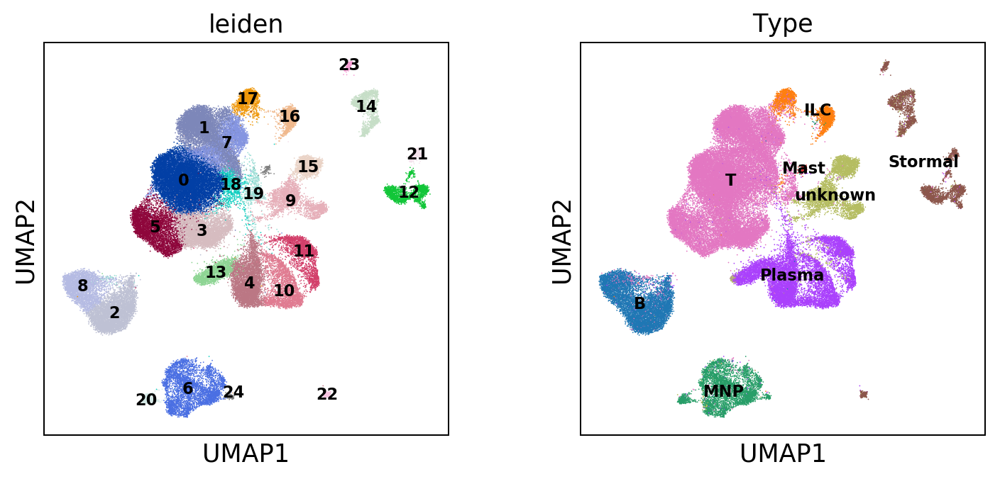

In [7]:
sc.pl.umap(adata, color=['leiden', 'Type'], legend_loc='on data', legend_fontsize=9)

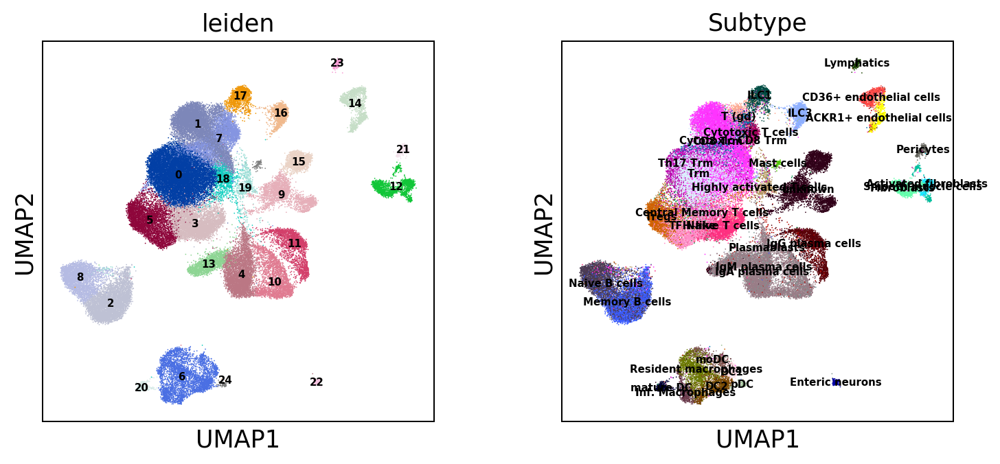

In [8]:
sc.pl.umap(adata, color=['leiden', 'Subtype'], legend_loc='on data', legend_fontsize=6)

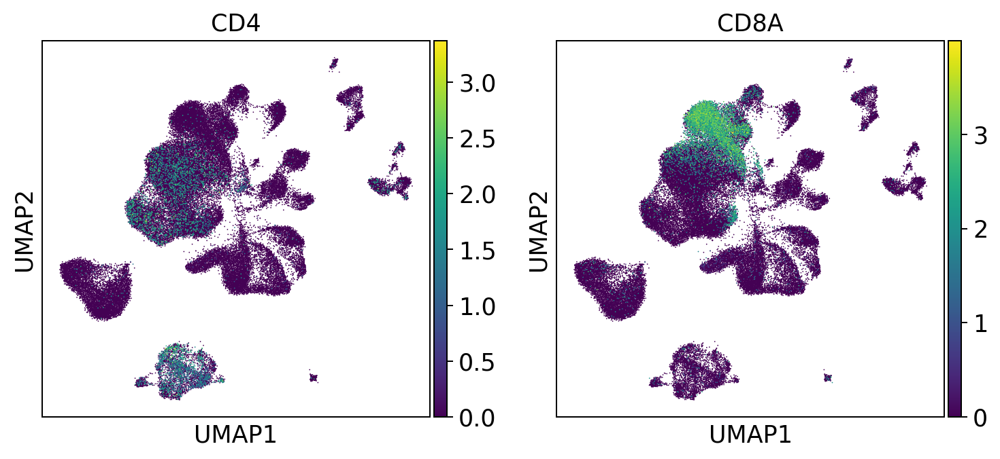

In [9]:
sc.pl.umap(adata, color=['CD4', 'CD8A'])

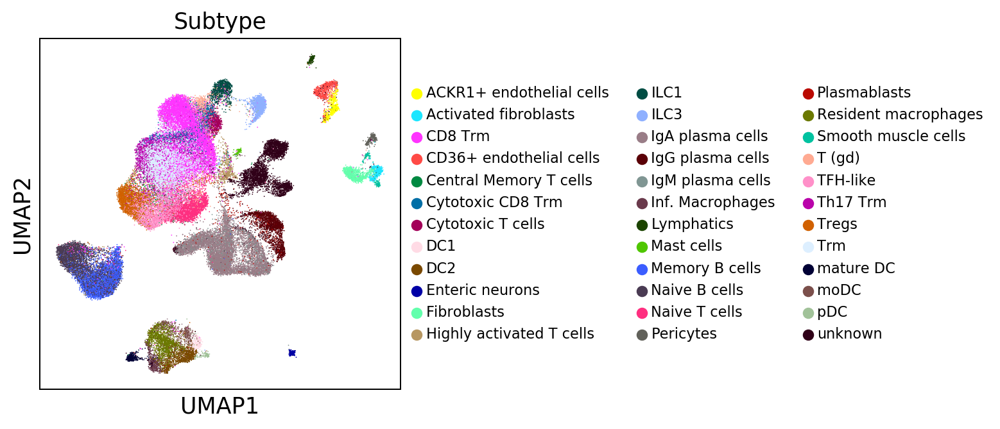

In [10]:
sc.pl.umap(adata, color=['Subtype'], legend_fontsize=9)

In [11]:
# Load GMT file and calculate signature scores
gmt_file_IMM=pkg_resources.resource_filename('besca', 'datasets/genesets/HumanCD45p_scseqCMs6.gmt')
gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')

adata_IMM_scores = adata.copy()
adata_anno_scores = adata.copy()

bc.tl.sig.combined_signature_score(adata_IMM_scores, gmt_file_IMM)
bc.tl.sig.combined_signature_score(adata_anno_scores, gmt_file_anno)

computing score 'score_HumanCD45p_scseqCMs6_ActB_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_ActB_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Activation_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Activation_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Basophil_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Bcells_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_CCG1S_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_CCG2M_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_CCG2M_scanpyUP', score of g

    finished: added
    'score_HumanCD45p_scseqCMs6_NKT_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_NKcells_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKcells_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_NKcyt_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKcyt_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_NKnai_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NKnai_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_Naive_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_Naive_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_NaiveB_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_NaiveB_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs

computing score 'score_HumanCD45p_scseqCMs6_allSteml_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_allSteml_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_cDC1_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDC1_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_cDC2_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDC2_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_cDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_cDCs_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_epDCs_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_HumanCD45p_scseqCMs6_general_scanpyUP'
    finished: added
    'score_HumanCD45p_scseqCMs6_general_scanpyUP', score of gene set (ada

computing score 'score_CytotoxCD8Tcell_scanpyUP'
    finished: added
    'score_CytotoxCD8Tcell_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_ExhCD8Tcell_scanpyUP'
    finished: added
    'score_ExhCD8Tcell_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_cDC_CCR7_scanpyUP'
    finished: added
    'score_cDC_CCR7_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_Langerhans_scanpyUP'
    finished: added
    'score_Langerhans_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_Macrophage_MSR1_scanpyUP'
    finished: added
    'score_Macrophage_MSR1_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_Macrophage_CXCL9_scanpyUP'
    finished: added
    'score_Macrophage_CXCL9_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_Monocyte_scanpyUP'
    finished: added
    'score_Monocyte_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score

    finished: added
    'score_EpithelialStem_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_IgAPlasma_scanpyUP'
    finished: added
    'score_IgAPlasma_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_IgGPlasma_scanpyUP'
    finished: added
    'score_IgGPlasma_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_IgMPlasma_scanpyUP'
    finished: added
    'score_IgMPlasma_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_ILC1_scanpyUP'
    finished: added
    'score_ILC1_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_ILC3_scanpyUP'
    finished: added
    'score_ILC3_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_ActTcell_scanpyUP'
    finished: added
    'score_ActTcell_scanpyUP', score of gene set (adata.obs) (0:00:00)
computing score 'score_NaiTcell_scanpyUP'
    finished: added
    'score_NaiTcell_scanpyUP', score of gene set (ada

In [12]:
adata_anno_scores

AnnData object with n_obs × n_vars = 62202 × 1417 
    obs: 'CELL', 'CONDITION', 'Sample_geo_accession', 'Sample_title', 'Subject', 'tissue', 'status', '10x chemistry', 'Sample_relation', 'Sample_relation_2', 'Sample_supplementary_file_1', 'Sample_supplementary_file_2', 'Sample_supplementary_file_3', 'ID_REF', 'Barcode', 'Type', 'Cluster', 'Lane', 'Subtype', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_Bcell_scanpy', 'score_Fibroblast_scanpy', 'score_Endothelial_scanpy', 'score_Epithelial_scanpy', 'score_Granulocyte_scanpy', 'score_MelMelanoma_scanpy', 'score_MemBcell_scanpy', 'score_Myeloid_scanpy', 'score_NKcell_scanpy', 'score_NaiBcell_scanpy', 'score_Neutrophil_scanpy', 'score_Plasma_scanpy', 'score_CD4Tcell_scanpy', 'score_CD8Tcell_scanpy', 'score_Tcell_scanpy', 'score_CD8Tcell_IL7Rmax_scanpy', 'score_CD4Tcell_IL7Rmax_scanpy', 'score_RegTcell_scanpy', 'score_cDC1_scanpy', 'score_cDC2_scanpy', 'score_cDC_scanpy', 'score_NClassMonocyte_scanpy', 'score_pDC_scanpy'

In [13]:
adata_IMM_scores

AnnData object with n_obs × n_vars = 62202 × 1417 
    obs: 'CELL', 'CONDITION', 'Sample_geo_accession', 'Sample_title', 'Subject', 'tissue', 'status', '10x chemistry', 'Sample_relation', 'Sample_relation_2', 'Sample_supplementary_file_1', 'Sample_supplementary_file_2', 'Sample_supplementary_file_3', 'ID_REF', 'Barcode', 'Type', 'Cluster', 'Lane', 'Subtype', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'score_HumanCD45p_scseqCMs6_ActB_scanpy', 'score_HumanCD45p_scseqCMs6_Activation_scanpy', 'score_HumanCD45p_scseqCMs6_Basophil_scanpy', 'score_HumanCD45p_scseqCMs6_Bcells_scanpy', 'score_HumanCD45p_scseqCMs6_CCG1S_scanpy', 'score_HumanCD45p_scseqCMs6_CCG2M_scanpy', 'score_HumanCD45p_scseqCMs6_Cafs_scanpy', 'score_HumanCD45p_scseqCMs6_Cellcycle_scanpy', 'score_HumanCD45p_scseqCMs6_Checkpoint_scanpy', 'score_HumanCD45p_scseqCMs6_Cyto_scanpy', 'score_HumanCD45p_scseqCMs6_Cytotox_scanpy', 'score_HumanCD45p_scseqCMs6_DCR_scanpy', 'score_HumanCD45p_scseqCMs6_DCrec_scanpy', 'score_

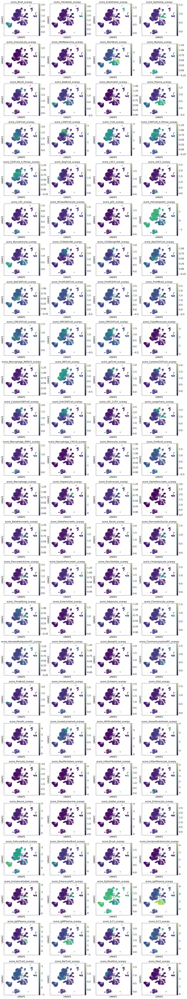

In [14]:
scores = [x for x in adata_anno_scores.obs.columns if 'scanpy' in x]
sc.pl.umap(adata_anno_scores, color=scores, color_map='viridis')

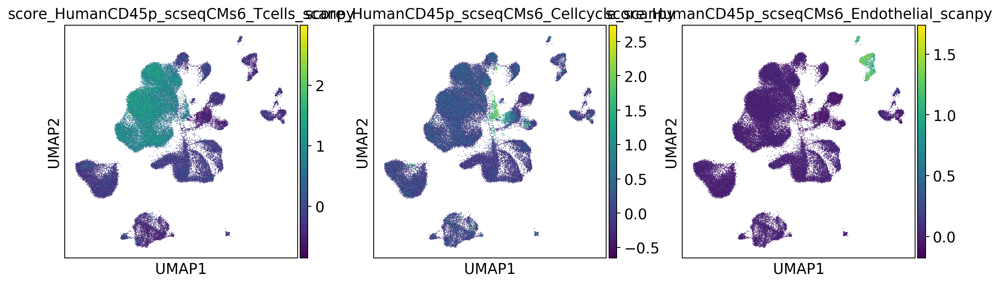

In [15]:
sc.pl.umap(adata_IMM_scores, color=['score_HumanCD45p_scseqCMs6_Tcells_scanpy',
                                     'score_HumanCD45p_scseqCMs6_Cellcycle_scanpy',
                                     'score_HumanCD45p_scseqCMs6_Endothelial_scanpy'], legend_loc='on data',legend_fontsize=6)

In [16]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['CD4-positive, alpha-beta memory T cell', 'CD8-positive, alpha-beta cytotoxic T cell', 
                     'memory B cell', 'naive T cell', 'IgM or IgA plasma cell', 'regulatory T cell', 'myeloid leukocyte', 
                     'CD8-positive, alpha-beta memory T cell', 'naive B cell', 'intestinal epithelial cell', 
                     'IgM or IgA plasma cell', 'IgG plasma cell', 'fibroblast', 'IgM or IgA plasma cell', 
                     'blood vessel endothelial cell', 'intestinal epithelial cell', 'group 3 innate lymphoid cell', 
                     'group 1 innate lymphoid cell', 'memory T cell', 'proliferating T cell', 'myeloid dendritic cell', 
                     'pericyte cell', 'neural cell', 'HEV endothelial cell', 'plasmacytoid dendritic cell']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='leiden', new_annotation_label='dblabel', new_cluster_labels=new_cluster_names)

In [17]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['T cell', 'T cell', 'B cell', 'T cell', 'plasma cell', 'T cell', 'myeloid leukocyte', 'T cell', 
                     'B cell', 'epithelial cell', 'plasma cell', 'plasma cell', 'fibroblast', 'plasma cell', 
                     'endothelial cell', 'epithelial cell', 'ILC3', 'ILC1', 'T cell', 'T cell', 'cDC', 'pericyte cell', 
                     'neural cell', 'endothelial cell', 'pDC']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='leiden', new_annotation_label='celltype', new_cluster_labels=new_cluster_names)

In [18]:
#write down new cluster names (important order needs to be equivalent to above)
new_cluster_names = ['0: T cell', '1: T cell', '2: B cell', '3: T cell', '4: plasma cell', '5: T cell', '6: myeloid leukocyte',
                     '7: T cell', '8: B cell', '9: epithelial cell', '10: plasma cell', '11: plasma cell', 
                     '12: fibroblast', '13: plasma cell', '14: endothelial cell', '15: epithelial cell', 
                     '16: ILC3', '17: ILC1', '18: T cell', '19: T cell', '20: cDC', '21: pericyte cell', 
                     '22: neural cell', '23: endothelial cell', '24: pDC']

    
bc.tl.annotate_cells_clustering(adata=adata, clustering_label='leiden', new_annotation_label='cluster_celltype', new_cluster_labels=new_cluster_names)

In [19]:
adata = bc.st.additional_labeling(adata, 'dblabel', 'dblabel', 'Curated celltype annotation.', 'Klas Hatje', outdir_data)

ranking genes


... storing 'dblabel' as categorical
... storing 'celltype' as categorical
... storing 'cluster_celltype' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:36)
rank genes per label calculated using method wilcoxon.
mapping of cells to  dblabel exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/dblabel/WilxRank.logFC.gct written out


In [20]:
adata = bc.st.additional_labeling(adata, 'celltype', 'celltype', 'Manual celltype annotation.', 'Klas Hatje', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:31)
rank genes per label calculated using method wilcoxon.
mapping of cells to  celltype exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/celltype/WilxRank.logFC.gct written out


In [21]:
adata = bc.st.additional_labeling(adata, 'Type', 'Martin2019_Type', 'Cell type annotation from authors [Martin2019].', 'Martin et al', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:27)
rank genes per label calculated using method wilcoxon.
mapping of cells to  Type exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Type/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Type/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Type/WilxRank.logFC.gct written out


In [22]:
adata = bc.st.additional_labeling(adata, 'Subtype', 'Martin2019_Subtype', 'Cell subtype annotation from authors [Martin2019].', 'Martin et al', outdir_data)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:46)
rank genes per label calculated using method wilcoxon.
mapping of cells to  Subtype exported successfully to cell2labels.tsv
average.gct exported successfully to file
fract_pos.gct exported successfully to file
labelinfo.tsv successfully written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Subtype/WilxRank.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Subtype/WilxRank.pvalues.gct written out
./analyzed/standard_workflow_besca2_0/labelings/Martin2019_Subtype/WilxRank.logFC.gct written out


In [23]:
adata.write(filename=os.path.join(outdir_data, 'Martin2019_processed.h5ad'), )

# Compare to signature decision tree based annotation

In [24]:
gmt_file_anno=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_sigs.gmt')

mymarkers  = bc.tl.sig.read_GMT_sign(gmt_file_anno,directed=False)
mymarkers = bc.tl.sig.filter_siggenes(adata, mymarkers) ### remove genes not present in dataset or empty signatures
mymarkers['Ubi'] = ['B2M','ACTB', 'GAPDH'] ### used for cutoff adjustment

In [25]:
configfile=pkg_resources.resource_filename('besca', 'datasets/genesets/CellNames_scseqCMs6_config.tsv')

sigconfig,levsk=bc.tl.sig.read_annotconfig(configfile)

# Fract_pos was exported by BESCA in the standard worflow
f=pd.read_csv(results_folder + "/labelings/leiden/fract_pos.gct",sep="\t",skiprows=2)
df=bc.tl.sig.score_mw(f,mymarkers)
myc=np.median(df.loc['Ubi',:]*0.5) ### Set a cutoff based on Ubi and scale with values from config file

# Cluster attribution based on cutoff
df=df.drop('Ubi')
sigscores={}
for mysig in list(df.index):
    sigscores[mysig]=bc.tl.sig.getset(df,mysig,sigconfig.loc[mysig,'Cutoff']*myc)
    #sigscores[mysig]=bc.tl.sig.getset(df,mysig,10)

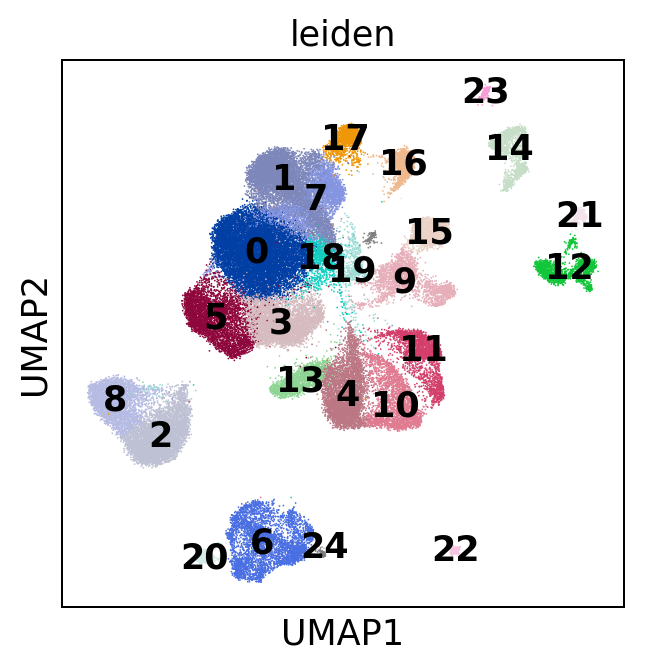

In [26]:
sc.pl.umap(adata, color=['leiden'], legend_loc='on data')

In [27]:
### Check here if your favorite cluster has the correct attribution
### Clusters will be attributed in the order specified in levsk
### To change the attribution order, change the rank in the configuration table
sigscores

{'Bcell': {'2', '8'},
 'Fibroblast': {'12', '21'},
 'Endothelial': {'14', '23'},
 'Epithelial': {'15', '9'},
 'Granulocyte': set(),
 'MelMelanoma': set(),
 'MemBcell': {'10', '11', '13', '18', '19', '2', '24', '4', '5', '8'},
 'Myeloid': {'10', '11', '13', '2', '20', '24', '4', '6', '8'},
 'NKcell': {'16', '17', '7'},
 'NaiBcell': {'2', '8'},
 'Neutrophil': set(),
 'Plasma': {'10', '11', '13', '18', '2', '4', '8'},
 'CD4Tcell': {'0',
  '1',
  '10',
  '11',
  '12',
  '13',
  '14',
  '15',
  '16',
  '17',
  '18',
  '19',
  '2',
  '20',
  '21',
  '23',
  '24',
  '3',
  '4',
  '5',
  '6',
  '7',
  '8',
  '9'},
 'CD8Tcell': {'1', '18', '3', '7'},
 'Tcell': {'0', '1', '17', '18', '19', '3', '5', '7', '8'},
 'CD8Tcell_IL7Rmax': {'7'},
 'CD4Tcell_IL7Rmax': {'7'},
 'RegTcell': {'20', '5'},
 'cDC1': set(),
 'cDC2': {'6'},
 'cDC': {'20', '6'},
 'NClassMonocyte': set(),
 'pDC': {'24'},
 'Hematopoetic': {'0',
  '1',
  '10',
  '11',
  '12',
  '13',
  '14',
  '15',
  '16',
  '17',
  '18',
  '19',
  '

In [28]:
cnames=bc.tl.sig.make_anno(df,sigscores,sigconfig,levsk)

In [29]:
cnames

,celltype0,celltype1,celltype2,celltype3
21,Fibroblast,Fibroblast,Fibroblast,Fibroblast
7,Hematopoetic,Tcell,CD8Tcell,CD8Tcell_IL7Rmax
2,Hematopoetic,Blymphocyte,Bcell,MemBcell
19,Hematopoetic,Tcell,CD4Tcell,ProlifCD4Tcell
0,Hematopoetic,Tcell,CD4Tcell,CMCD4Tcell
10,Hematopoetic,Blymphocyte,Plasma,Plasma
16,Hematopoetic,NKcell,NKcell,NKcell
13,Hematopoetic,Blymphocyte,Plasma,Plasma
17,Hematopoetic,Tcell,CD4Tcell,CytotoxCD4Tcell
6,Hematopoetic,Myeloid,cDC,cDC2


In [30]:
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnames,'celltype0','leiden')
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnames,'celltype1','leiden')
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnames,'celltype2','leiden')
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnames,'celltype3','leiden')

In [31]:
adata

AnnData object with n_obs × n_vars = 62202 × 1417 
    obs: 'CELL', 'CONDITION', 'Sample_geo_accession', 'Sample_title', 'Subject', 'tissue', 'status', '10x chemistry', 'Sample_relation', 'Sample_relation_2', 'Sample_supplementary_file_1', 'Sample_supplementary_file_2', 'Sample_supplementary_file_3', 'ID_REF', 'Barcode', 'Type', 'Cluster', 'Lane', 'Subtype', 'percent_mito', 'n_counts', 'n_genes', 'batch', 'leiden', 'dblabel', 'celltype', 'cluster_celltype', 'celltype0', 'celltype1', 'celltype2', 'celltype3'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'Type_colors', 'Subtype_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

... storing 'celltype0' as categorical
... storing 'celltype1' as categorical
... storing 'celltype2' as categorical
... storing 'celltype3' as categorical


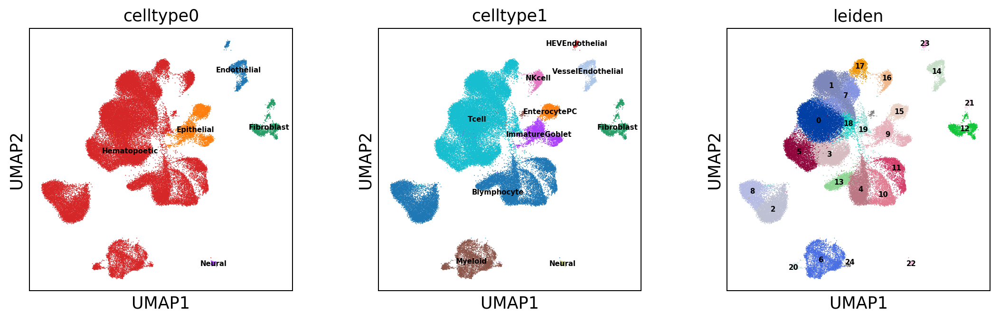

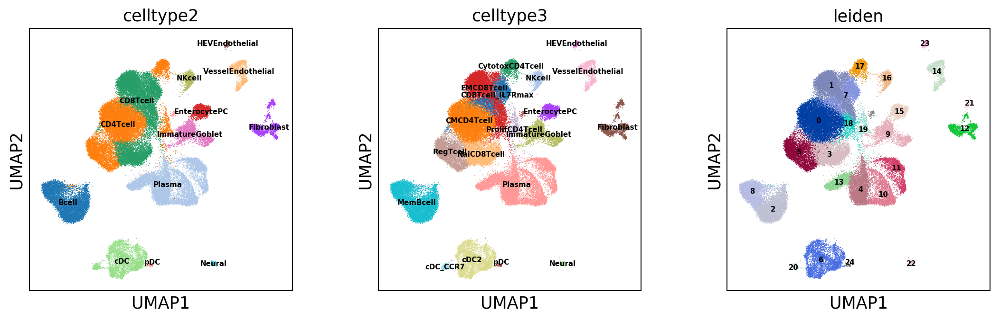

In [32]:
sc.pl.umap(adata, color=['celltype0','celltype1', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['celltype2','celltype3', 'leiden'], legend_loc='on data',legend_fontsize=6)

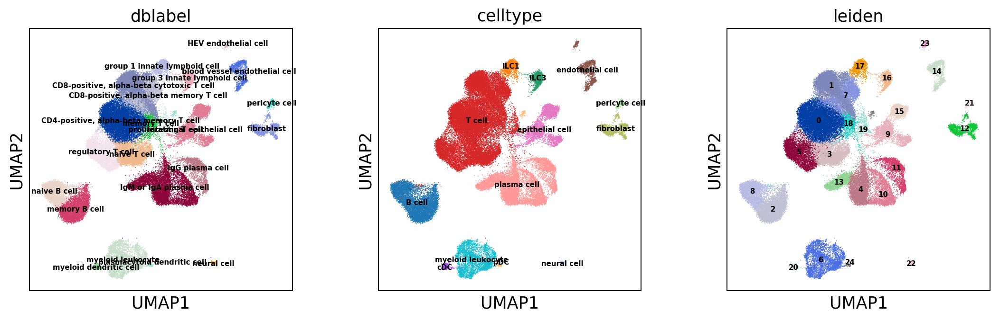

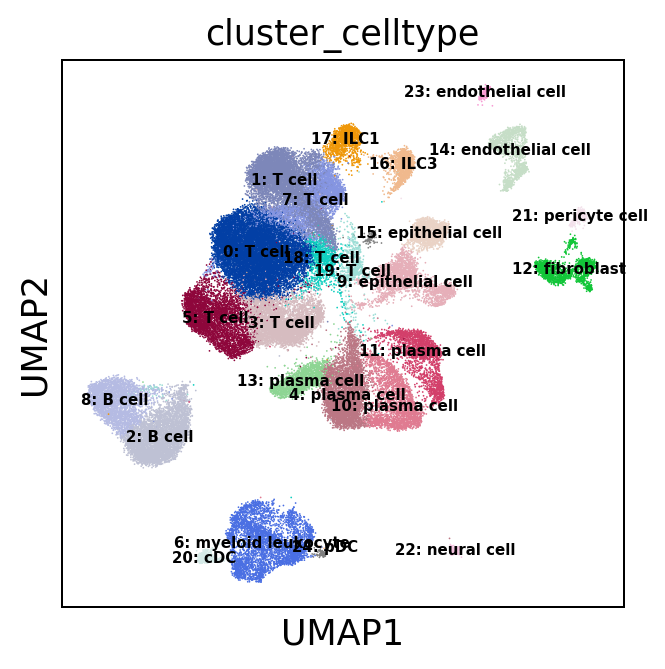

In [33]:
sc.pl.umap(adata, color=['dblabel','celltype', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['cluster_celltype'], legend_loc='on data',legend_fontsize=6)

In [ ]:
sc.pl.umap(adata, color=['Type','Subtype', 'leiden'], legend_loc='on data',legend_fontsize=6)
sc.pl.umap(adata, color=['Subtype'], legend_fontsize=6)

In [40]:
adata.obs.columns

Index(['CELL', 'CONDITION', 'Sample_geo_accession', 'Sample_title', 'Subject',
       'tissue', 'status', '10x chemistry', 'Sample_relation',
       'Sample_relation_2', 'Sample_supplementary_file_1',
       'Sample_supplementary_file_2', 'Sample_supplementary_file_3', 'ID_REF',
       'Barcode', 'Type', 'Cluster', 'Lane', 'Subtype', 'percent_mito',
       'n_counts', 'n_genes', 'batch', 'leiden', 'dblabel', 'celltype',
       'cluster_celltype', 'celltype0', 'celltype1', 'celltype2', 'celltype3'],
      dtype='object')